## *Global Terrorism  is a criminal act that seeks to create fear and terror amongst the general public or a particular group of people for political purposes. It is an unjustifiable means of achieving political, ideological, or religious goals, and is condemned by the International community.*

**OBJECTIVES**


*   On a data set ‘Global Terrorism’ we perform EDA (‘Exploratory Data Analysis’)

*   to find out the hot zone of terrorism, we act as a security/defense analyst

*   Identify trends and patterns in terrorist activities

*  Study of  the nature  of terrorism, such as the types of attacks, the regions that are most affected, the groups involved, and the factors that contribute to the occurrence of terrorist activities.


In [2]:
from google.colab import drive
drive.mount ('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## ***Let's import to our data and check the basics.***

In [3]:
import pandas as pd
import missingno as msno
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

In [4]:
path = "/content/drive/MyDrive/AlmaBetter Datascience/Datasets/Global Terrorism Data.csv"
df = pd.read_csv(path , encoding = "ISO-8859-1")

<ipython-input-4-9da1a0dd0fbe>:2: DtypeWarning: Columns (4,6,31,33,61,62,63,76,79,90,92,94,96,114,115,121) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(path , encoding = "ISO-8859-1")


In [5]:
df.shape

(181691, 135)

In [6]:
df.head(5)


,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


In [7]:
df.tail(5)


,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
181686,201712310022,2017,12,31,NaN,0,NaN,182,Somalia,11,...,NaN,"""Somalia: Al-Shabaab Militants Attack Army Che...","""Highlights: Somalia Daily Media Highlights 2 ...","""Highlights: Somalia Daily Media Highlights 1 ...",START Primary Collection,0,0,0,0,NaN
181687,201712310029,2017,12,31,NaN,0,NaN,200,Syria,10,...,NaN,"""Putin's 'victory' in Syria has turned into a ...","""Two Russian soldiers killed at Hmeymim base i...","""Two Russian servicemen killed in Syria mortar...",START Primary Collection,-9,-9,1,1,NaN
181688,201712310030,2017,12,31,NaN,0,NaN,160,Philippines,5,...,NaN,"""Maguindanao clashes trap tribe members,"" Phil...",NaN,NaN,START Primary Collection,0,0,0,0,NaN
181689,201712310031,2017,12,31,NaN,0,NaN,92,India,6,...,NaN,"""Trader escapes grenade attack in Imphal,"" Bus...",NaN,NaN,START Primary Collection,-9,-9,0,-9,NaN
181690,201712310032,2017,12,31,NaN,0,NaN,160,Philippines,5,...,NaN,"""Security tightened in Cotabato following IED ...","""Security tightened in Cotabato City,"" Manila ...",NaN,START Primary Collection,-9,-9,0,-9,NaN


##  No of terrorist attacks per year.




In [8]:
attack_per_year=df['iyear'].value_counts()

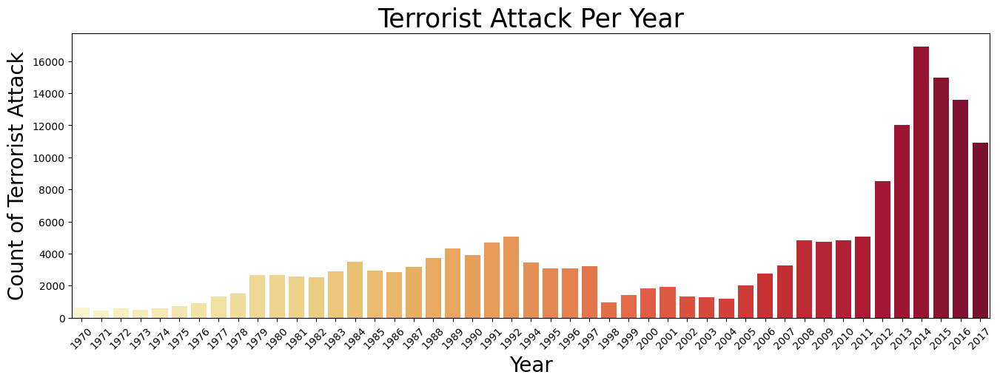

In [22]:
ax=plt.rcParams['figure.figsize'] = 16,5
ax=sns.countplot(x='iyear',palette='YlOrRd',data=df)
ax.set_xlabel('Year',fontsize=20)
plt.xticks(rotation = 45)
ax.set_ylabel('Count of Terrorist Attack',fontsize=20)
ax.set_title('Terrorist Attack Per Year',fontsize=25);

INFERENCE:The above graph shows us the attacks took place from year **1970-2017**

' The **highest** number of attacks took place in year **2014** '

## Terrorist Activities by Region in each Year.

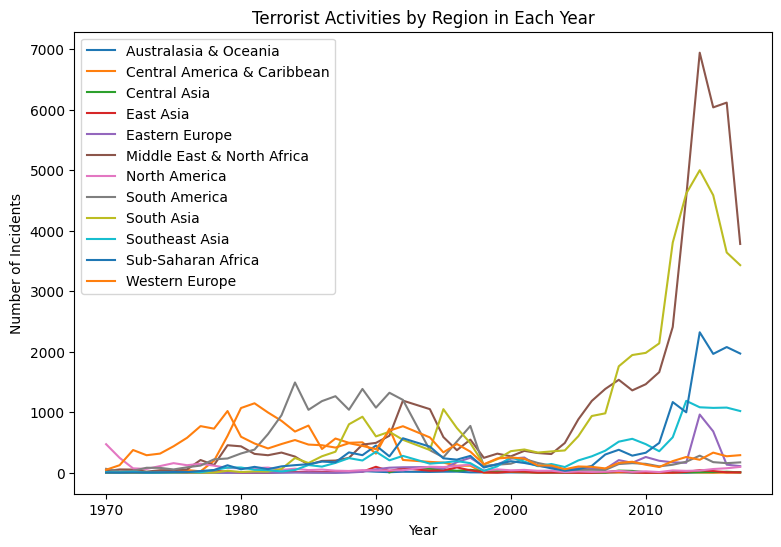

In [10]:
grouped = df.groupby(['region_txt', 'iyear'])['eventid'].count().reset_index()

fig, ax = plt.subplots(figsize=(9,6))
for region in grouped['region_txt'].unique():
    region_data = grouped[grouped['region_txt'] == region]
    ax.plot(region_data['iyear'], region_data['eventid'], label=region)

ax.set_title('Terrorist Activities by Region in Each Year')
ax.set_xlabel('Year')
ax.set_ylabel('Number of Incidents')
ax.legend()
plt.show()

INFERENCE: By using Line Chart we have anaylised the terrorist activities in every region of the world in each year
*   The terrorist activities took place more in **western europe** region from mid of  year **1970** till mid of year **1990**
*   And the terrorist activities were more active in **Central America** and **Carribean** region from year **1970** to year **2000** and it has gradually decreased.

*  The terrorist activities which is not decreasing from **year 1970 till now** is **Middle East** and **North Africa** its rather getting increased.

Observation: The **areas affected the most** are **Middle East** and
           **North Africa**



# Terrorist agencies and their success rate

Lets visualize the top active agencies and how successful they are in their attacks.

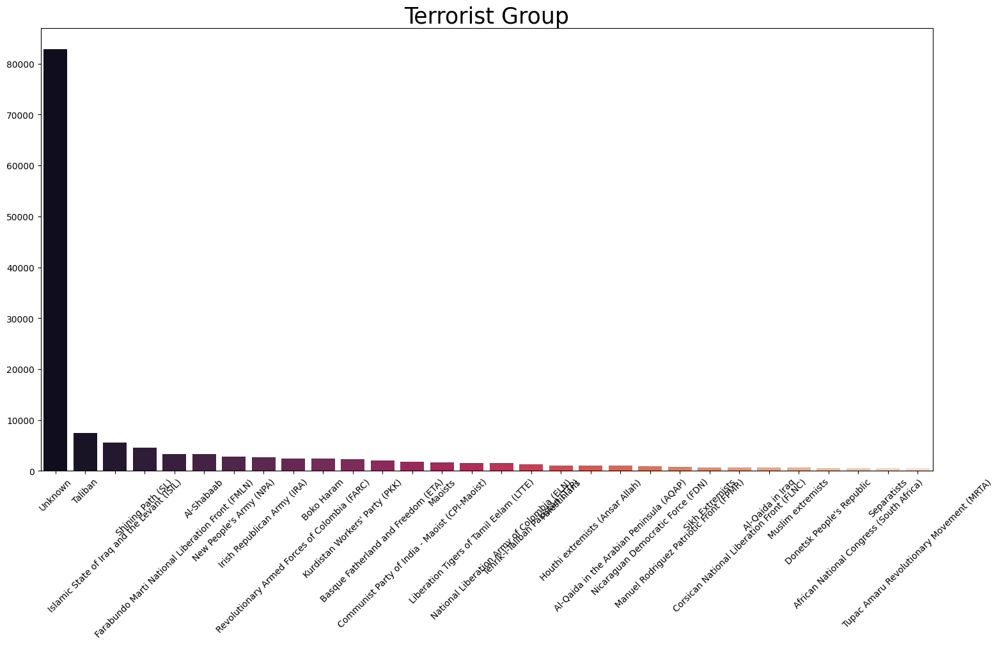

In [11]:
ax=plt.rcParams['figure.figsize'] = 18,9
ax = sns.countplot(x='gname', palette='rocket', data=df,order = df['gname'].value_counts().index[:30])
ax.set_title('Terrorist Group',fontsize=25)
ax.set_xlabel('',fontsize=8)
ax.set_ylabel('')
ax.tick_params(axis='x', rotation=45)
plt.show()

Here we have used bar chart to analyise the top 30 groups of terrorist who have done most of the attacks overall

**On the top** is the **Unknown** group. This means its not a single group but they belong to different groups with certain motives, and they are not active all the time and not so popular.

**Second most active group** of terrorist is **Taliban**

## The weapons mostly used by the agencies in attacks

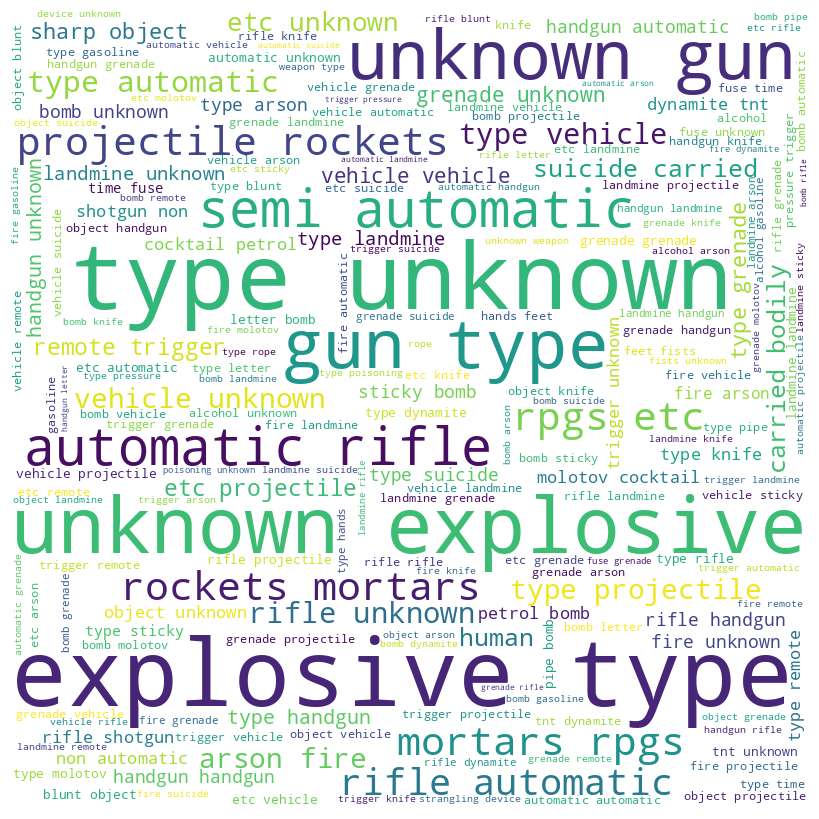

In [12]:
from wordcloud import WordCloud


cities = df['weapsubtype1_txt'].dropna().astype(str).str.lower().str.cat(sep=' ')#str.cat(sep=' ') method to concatenate all the city names with a space separator.


wordcloud = WordCloud(width=800, height=800, background_color='white').generate(cities)
plt.figure(figsize=(8, 8), facecolor=None)
plt.imshow(wordcloud)
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()


**Inference:** Here we have visualised the type of **weapons most frequently used** by the Terrorist Agencies using **Wordcloud**, i.e **Explosives** .

## Types of attack

 Different types of attacked used by terrorists visulazised below using pie chart




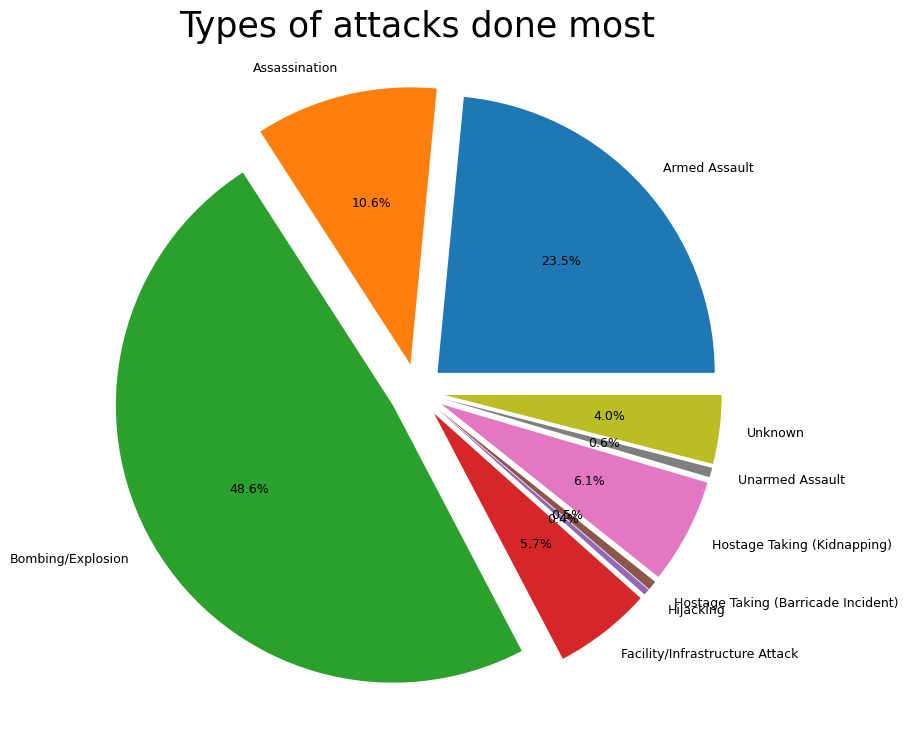

In [13]:
df_grouped = df.groupby('attacktype1_txt').size().reset_index(name='counts')
explode = (0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1)
plt.pie(df_grouped['counts'], labels=df_grouped['attacktype1_txt'], autopct='%1.1f%%',explode=explode, textprops={'fontsize': 9})
plt.title("Types of attacks done most",fontsize=25 )
plt.show()


INFERENCE: Here we have used a Pie chart and analysed that the attacks were mostly done by the **Bombing/Explosion.** i.e **48.6%** among all.

###**Countries which have faced the highest number of GunsAttack**

In [14]:
df_gunsAttack = df.query("gname == 'Unknown'").groupby(["country_txt"])["nkill"].count()
df_gunsAttack

country_txt
Afghanistan            4735
Albania                  75
Algeria                1172
Angola                   61
Antigua and Barbuda       0
                       ... 
Yemen                   989
Yugoslavia              122
Zaire                    33
Zambia                   29
Zimbabwe                 53
Name: nkill, Length: 192, dtype: int64

In [23]:
pd.options.plotting.backend = "plotly"
fig = df_gunsAttack.plot()
fig.show()

This is the visualizaton of Terrorist activities which are various types of **Guns Assault** directly to the **civillians** of different countries with their amount of **Severity** across the years.

**Top 5 Countries in the list with their numbers are:**
* **Iraq** - 18,287
* **Pakistan** - 10,691
* **Afghanistan** - 4735
* **India** - 4191
* **Thailand** - 3002

# **Geospacial Visualization** using Follium Marker-Cluster.

We are visualising data of attacks took place in a **single year** and we have selected **year 2014** since it is the **year with most no. of attacks**.

In [16]:
import folium
from folium.plugins import MarkerCluster
filterYear = df['iyear'] == 2014

In [17]:
filterData = df[filterYear] # filter data
# filterData.info()
reqFilterData = filterData.loc[:,'city':'longitude'] #We are getting the required fields
reqFilterData = reqFilterData.dropna() # drop NaN values in latitude and longitude
reqFilterDataList = reqFilterData.values.tolist()
# reqFilterDataList

In [18]:
map = folium.Map(location = [0, 30], tiles='CartoDB positron', zoom_start=2)
# clustered marker
markerCluster = folium.plugins.MarkerCluster().add_to(map)
for point in range(0, len(reqFilterDataList)):
    folium.Marker(location=[reqFilterDataList[point][1],reqFilterDataList[point][2]],
                  popup = reqFilterDataList[point][0]).add_to(markerCluster)
map

Here we can visualize the **locations** in which the attacks took place using the **Latitudes** and **Longitudes** columns given in the data **Geospacially**.

#**Correlation Heatmap**

<ipython-input-19-038494e9a1cd>:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



<Axes: >

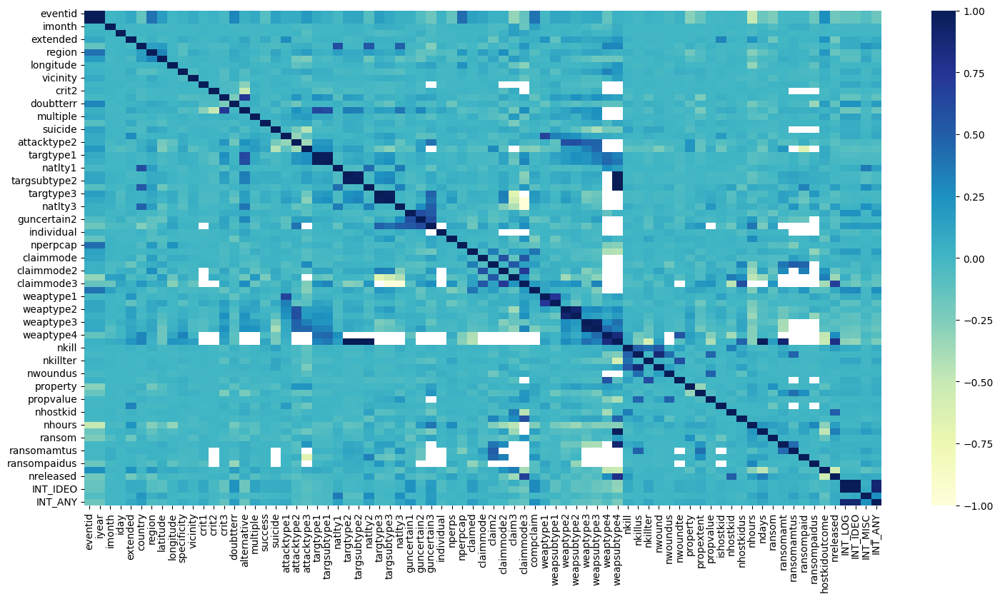

In [19]:
sns.heatmap(df.corr(),cmap="YlGnBu")


This is the correlation heatmap and by visualsing this we got a lot of insights for any further Machine Learning approaches to be applied on this dataset.
Some of these insights look like:

* **'targsubtype2'** and **'targtype3'** columns are highly correlated with **'weaptype4'** and **'weapsubtype4'** columns.
* **nkill** is highly correlated with **'ndays'** ,**'ransomamt'**,**'targtype2'**, **'targsubtype2'** and **'natlty2'**  columns.
* **'attacktype2'** has partially good correlation with **'weaptype1'** but not so significant correlation with **'weapsubtype1'**.
etc.

In this dataset there are **135 columns** and clearly not all the columns are important at the same time, we can do a lot of **feature engineering** here to fit the data into  **Machine Learning algorithms** as per our requirements.